# Call marker for each circadian time

In [ ]:
ad.uns['leiden_subcluster_cellexES']

,gene,leiden_subcluster,enrichScore,expressed_ratio,expressed_ratio_others,det_pvals,det_esw_s,ep_pvals,ep_esw_s,ges_pvals,ges_esw_s,nsi_pvals,nsi_esw_s,significantCounts
0,AT1G01010,0,0.000000,0.015036,0.024957,1.000000,0.000000,0.995146,0.000000,0.996666,0.000000,0.975336,0.000000,0.0
1,AT1G01020,0,0.011383,0.093144,0.076550,0.072619,0.000000,0.914926,0.000000,0.034226,0.045534,0.418849,0.000000,1.0
2,AT1G01030,0,0.715670,0.076807,0.029077,0.000539,0.739105,0.005001,0.645823,0.000049,0.875720,0.003923,0.602031,4.0
3,AT1G01040,0,0.223642,0.267322,0.197766,0.001912,0.597662,0.676866,0.000000,0.006620,0.296906,0.139110,0.000000,2.0
4,AT1G03993,0,0.000000,0.000325,0.000300,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
588067,AT5G67600,9,0.000000,0.016734,0.021506,0.978523,0.000000,0.956997,0.000000,0.926988,0.000000,0.702707,0.000000,0.0
588068,AT5G67610,9,0.000000,0.034315,0.031377,0.054085,0.000000,0.085564,0.000000,0.124939,0.000000,0.242522,0.000000,0.0
588069,AT5G67620,9,0.000000,0.004660,0.013043,1.000000,0.000000,0.976611,0.000000,0.982005,0.000000,0.915760,0.000000,0.0
588070,AT5G67630,9,0.004373,0.026266,0.023072,0.043199,0.017491,0.121751,0.000000,0.083946,0.000000,0.336030,0.000000,1.0


In [ ]:
_dt = {}
for ct, _ad in singleCellTools.basic.splitAdata(ad, 'CT', needName=True):
    singleCellTools.geneEnrichInfo.calculateEnrichScoreByCellex(_ad, 'raw', 'leiden_subcluster')
    _dt[ct] = _ad.uns['leiden_subcluster_cellexES'].copy()

  0%|          | 0/12 [00:00<?, ?it/s]

100%|██████████| 12/12 [54:07<00:00, 270.60s/it]


In [ ]:
for ct in _dt.keys():
    _dt[ct] = _dt[ct].assign(ct=ct)

In [ ]:
df_cellexScoreForEachCt = pd.concat(_dt.values())

In [ ]:
def sMod(N, m, n1, n2):
    import math

    p = 0
    denominator = math.comb(N, n1) * math.comb(N, n2)
    for i in range(m, min(n1, n2) + 1):
        numerator = (
            math.comb(N, i) * math.comb(N - i, n1 - i) * math.comb(N - n1, n2 - i)
        )
        p += numerator / denominator
    return p

def sModForSpec(df_spec, compareKey):
    from itertools import product
    from joblib import Parallel, delayed
    from tqdm import tqdm

    df_smod = pd.DataFrame(
        index=df_spec[compareKey].unique(), columns=df_spec[compareKey].unique()
    )
    df_smod = df_smod.melt(ignore_index=False).reset_index()
    df_smod.columns = ["compareA", "compareB", "sMod_p"]

    N = len(df_spec["gene"].unique())

    for tp_line in tqdm(df_smod.itertuples(), total=df_smod.shape[0]):
        x = tp_line.compareA
        y = tp_line.compareB
        m = len(
            set(df_spec.query(f"{compareKey} == @x")["gene"])
            & set(df_spec.query(f"{compareKey} == @y")["gene"])
        )
        n = len(
            set(df_spec.query(f"{compareKey} == @x")["gene"])
            | set(df_spec.query(f"{compareKey} == @y")["gene"])
        )
        n1 = len(df_spec.query(f"{compareKey} == @x")["gene"].unique())
        n2 = len(df_spec.query(f"{compareKey} == @y")["gene"].unique())
        df_smod.loc[tp_line.Index, "N"] = N
        df_smod.loc[tp_line.Index, "m"] = m
        df_smod.loc[tp_line.Index, "n1"] = n1
        df_smod.loc[tp_line.Index, "n2"] = n2
        df_smod.loc[tp_line.Index, "n"] = n
    df_smod["N"] = df_smod["N"].astype(int)
    df_smod["m"] = df_smod["m"].astype(int)
    df_smod["n1"] = df_smod["n1"].astype(int)
    df_smod["n2"] = df_smod["n2"].astype(int)

    ls_modP = Parallel(n_jobs=64)(
        delayed(sMod)(N, m, n1, n2)
        for (N, m, n1, n2) in df_smod[["N", "m", "n1", "n2"]].itertuples(index=False)
    )
    df_smod["sMod_p"] = ls_modP
    df_smod.loc[df_smod["compareA"] == df_smod["compareB"], "sMod_p"] = np.nan
    df_smod["sMod"] = -np.log10(df_smod["sMod_p"])
    df_smod['jacIndex'] = df_smod['m'] / df_smod['n']
    df_smod.loc[df_smod["compareA"] == df_smod["compareB"], "jacIndex"] = np.nan

    return df_smod

In [ ]:
def plotSmodRes(df_sMod, vmax, height=5, width=5, sizes=[0, 0.1, 0.2, 0.3]):
    _df_jacIndex = df_sMod.pivot_table(index='compareA', columns='compareB', values='jacIndex')
    _df_sModP = df_sMod.pivot_table(index='compareA', columns='compareB', values='sMod_p')
    _df_sMod = df_sMod.pivot_table(index='compareA', columns='compareB', values='sMod')
    
    ls_ct = _df_sMod.index

    h = ma.Heatmap(_df_sMod.values, cmap='Reds', label='S-MOD', height=height, width=width, linewidth=1, vmax=vmax)
    _sr = _df_jacIndex.fillna(0).values.reshape(-1)

    h.add_layer(
        mp.SizedMesh(
            _df_jacIndex.fillna(0).values, color="none", edgecolor="#6E75A4", 
            size_legend_kws=dict(
                title='Jaccard Index', 
                show_at=np.interp(sizes, [_sr.min(), _sr.max()], [0,1]), 
                spacing='uniform'
            )
        )
    )
    h.add_left(mp.Colors(ls_ct, label='Circadian Time'), size=0.2, pad=0.05)

    h.add_top(mp.Colors(ls_ct, label='Circadian Time'), size=0.2, pad=0.05, legend=False)

    h.add_legends(stack_size=4)

    return h

In [ ]:
def plotJacRes(df_sMod, vmax, height=5, width=5):
    _df_jacIndex = df_sMod.pivot_table(index='compareA', columns='compareB', values='jacIndex')
    _df_sModP = df_sMod.pivot_table(index='compareA', columns='compareB', values='sMod_p')
    _df_sMod = df_sMod.pivot_table(index='compareA', columns='compareB', values='sMod')
    
    ls_ct = _df_sMod.index

    h = ma.Heatmap(_df_jacIndex.values, cmap='Reds', label='Jaccard Index', height=height, width=width, linewidth=1, vmax=vmax, annot=True, fmt=lambda _: round(_,2))
    _sr = _df_jacIndex.fillna(0).values.reshape(-1)

    h.add_left(mp.Colors(ls_ct, label='Circadian Time'), size=0.2, pad=0.05)

    h.add_top(mp.Colors(ls_ct, label='Circadian Time'), size=0.2, pad=0.05, legend=False)

    h.add_legends(stack_size=4)

    return h

In [ ]:
class OverlapBetweenCircadianTime(object):
    def __init__(self, df_cellexScoreForEachCt, enrichScoreCutoff, label):
        self.rawData = df_cellexScoreForEachCt
        self.data = df_cellexScoreForEachCt.assign(spec=lambda _: np.where(_.enrichScore>enrichScoreCutoff, True, False)).query("spec")
        self.enrichScoreCutoff = enrichScoreCutoff
        self.label = label
    def onlyKeepSpecGenes(self):
        _ls = self.rawData.query("enrichScore > @self.enrichScoreCutoff")['gene'].unique()
        self.rawData = self.rawData.query("gene in @_ls")
    def getIccValue(self):
        import pingouin as pg
        icc = pg.intraclass_corr(data=self.rawData, targets='gene', raters='ct',
                                ratings='enrichScore')
        self.icc = icc
    def getSmodAndJacIndex(self):
        self.sMod = sModForSpec(self.data, 'ct')

    def plotSmodRes(self, vmax, height=5, width=5, sizes=[0, 0.1, 0.2, 0.3]):
        return plotSmodRes(self.sMod, vmax, height, width, sizes=sizes)
    
    def plotJacRes(self, vmax=1, height=5, width=5):
        return plotJacRes(self.sMod, vmax, height, width)
    
    def plotSpecGeneCounts(self):
        _df = self.data.value_counts("gene").value_counts().to_frame().reset_index().rename(columns={'index':'geneCounts', 0:'ctCounts'}).sort_values('geneCounts')
        g = (
            so.Plot(_df, x='geneCounts', y='ctCounts', text='ctCounts')
            .add(so.Bar())
            .add(so.Text(valign='bottom'))
            .label(title=self.label)
            .scale(x=so.Continuous().tick(every=1))
        )
        fig = g.plot()._figure
        ax = fig.axes[0]
        for text in ax.texts:
            text.set(clip_on=False)
        return fig

## overlap

In [ ]:
ls_allSubcluster = df_cellexScoreForEachCt['leiden_subcluster'].unique()

In [ ]:
from tqdm import tqdm
dt_specOverlapInfo = {}
for cluster in tqdm(ls_allSubcluster):
    df_forIcc = df_cellexScoreForEachCt.query("leiden_subcluster == @cluster")
    overlapSpec = OverlapBetweenCircadianTime(df_forIcc, 0.8, f'Cluster {cluster}')
    overlapSpec.onlyKeepSpecGenes()
    overlapSpec.getIccValue()
    overlapSpec.getSmodAndJacIndex()
    dt_specOverlapInfo[cluster] = overlapSpec

100%|██████████| 24/24 [03:26<00:00,  8.61s/it]


In [ ]:
dt_icc = {}
for cluster, overlapSpec in tqdm(dt_specOverlapInfo.items()):
    pval = overlapSpec.icc.set_index("Type").loc['ICC2', 'pval']
    if pval < 0.05:
        dt_icc[cluster] = overlapSpec.icc.set_index("Type").loc['ICC2', 'ICC']
    else:
        dt_icc[cluster] = 0.0
dt_icc = {x:dt_icc[x] for x in sorted(dt_icc.keys(), key=lambda _: int(_.split(',')[0]))}

100%|██████████| 24/24 [00:00<00:00, 760.46it/s]


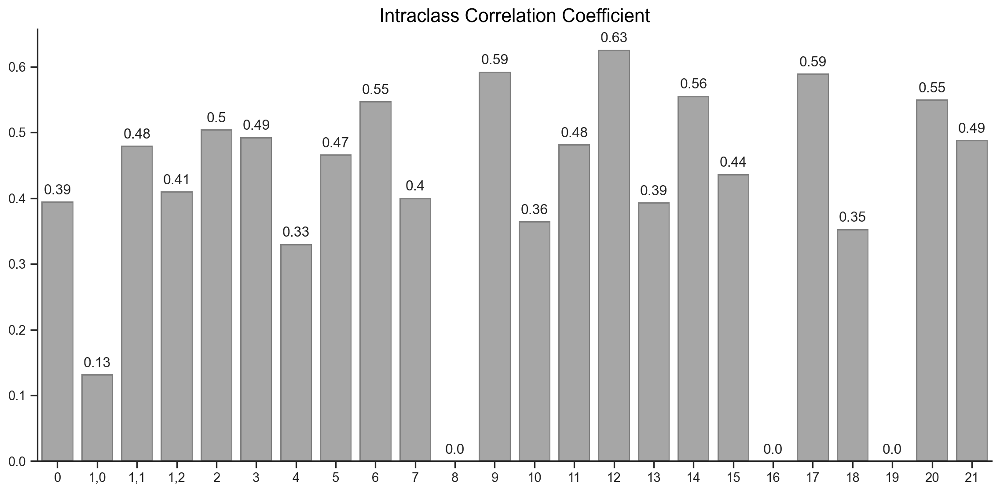

In [ ]:
(
    so.Plot(x=dt_icc.keys(), y=dt_icc.values(), text=list(dt_icc.values()) >> F(map, partial(round, ndigits=2)) >> F(list))
    .add(so.Bar())
    .add(so.Text(valign="bottom"))
    .layout(size=(12,6))
    .label(title='Intraclass Correlation Coefficient')
    .theme({'axes.titlesize':16})
)

In [ ]:
from IPython import display

In [ ]:
for cluster, overlapSpec in tqdm(dt_specOverlapInfo.items()):
    h = overlapSpec.plotSmodRes(None, sizes=[0,0.2,0.4])
    h.add_top(
        mp.Title(overlapSpec.label)
    )
    h.add_legends(stack_size=2)
    display.display(h.render())

In [ ]:
from jpy_tools.otherTools import FigConcate

In [ ]:
lsFig = []
dtFig = {}
for cluster, overlapSpec in tqdm(dt_specOverlapInfo.items()):
    h = overlapSpec.plotSmodRes(None, sizes=[0,0.2,0.4])
    h.add_top(
        mp.Title(overlapSpec.label)
    )
    h.add_legends(stack_size=2)
    fig, ax = plt.subplots()
    ax.remove()
    h.render(fig)
    plt.close()
    lsFig.append(FigConcate(fig))
    dtFig[cluster] = fig


100%|██████████| 24/24 [00:22<00:00,  1.09it/s]


In [ ]:
_ls = []
for i in range(0, len(lsFig), 4):
    _ls.append(reduce(lambda x,y: x|y, lsFig[i:i+8]))

In [ ]:
fig = reduce(lambda x,y: x/y, _ls)

In [ ]:
fig.show([20, 15])

In [ ]:
lsFig = []
for cluster, overlapSpec in tqdm(dt_specOverlapInfo.items()):
    fig = overlapSpec.plotSpecGeneCounts()
    lsFig.append(FigConcate(fig))

100%|██████████| 24/24 [00:13<00:00,  1.79it/s]


In [ ]:
_ls = []
for i in range(0, len(lsFig), 4):
    _ls.append(reduce(lambda x,y: x|y, lsFig[i:i+8]))

In [ ]:
fig = reduce(lambda x,y: x/y, _ls)

In [ ]:
fig.show([20, 15])

# annotate

## load public data

In [ ]:
ad_pub = sc.read_h5ad(f"{dir_result}/ad_pub_after_calc_sn_auc.h5ad")

## overlap method

In [ ]:
dt_pubSpecGenes = (
    ad_pub.uns["pub_cellex_cellexES"]
    .query("enrichScore > 0.9")
    .sort_values(["celltype", "enrichScore"], ascending=[True, False])
    .groupby("celltype")["gene"]
    .agg(list)
    .to_dict()
)

In [ ]:
df_specGeneJarccard = pd.DataFrame(
    index=dt_pubSpecGenes.keys(), columns=dt_specGenes.keys()
)
for k1, v1 in dt_pubSpecGenes.items():
    for k2, v2 in dt_specGenes.items():
        df_specGeneJarccard.loc[k1, k2] = len(set(v1) & set(v2)) / len(
            set(v1) | set(v2)
        )
df_specGeneJarccard = df_specGeneJarccard.astype(float)

In [ ]:
ls_geneCat = np.where(df_specGeneJarccard.index.str.contains(":"), "Shoot", "Root")

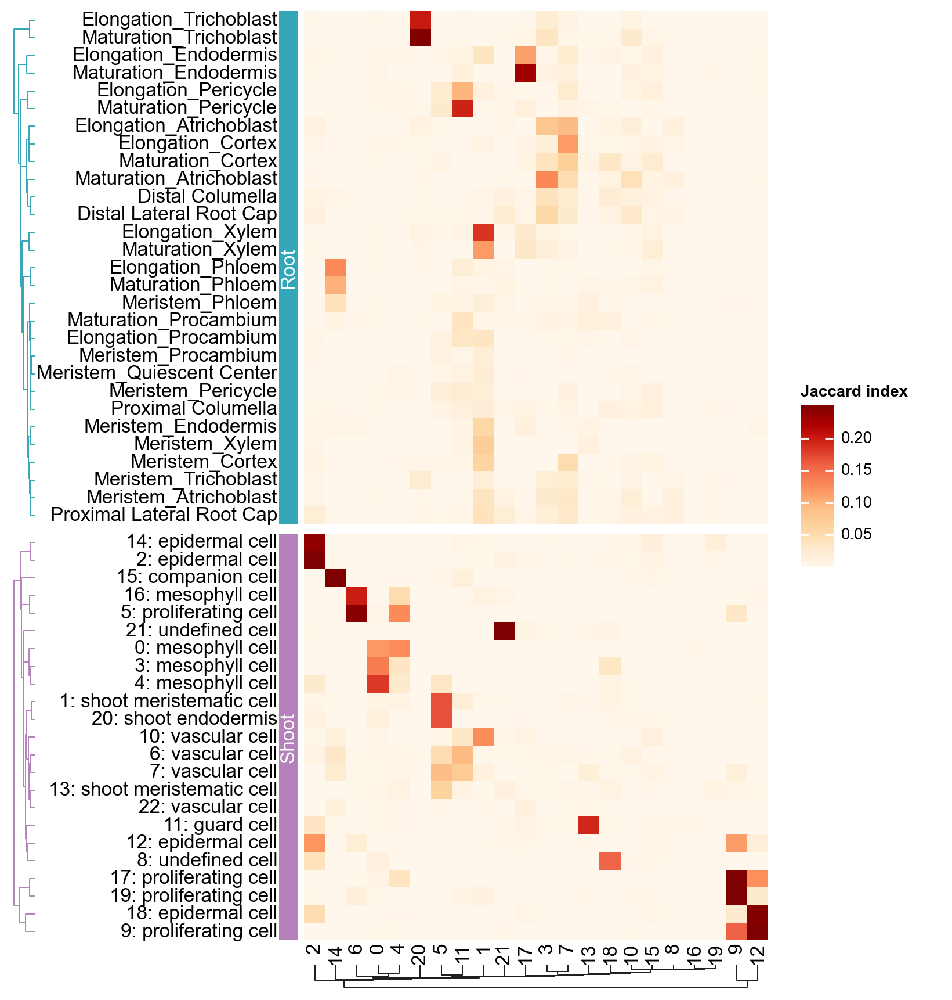

In [ ]:
g = ma.Heatmap(
    df_specGeneJarccard.values,
    cmap="OrRd",
    width=4,
    height=8,
    vmax=0.25,
    label="Jaccard index",
)

g.hsplit(labels=ls_geneCat, order=["Root", "Shoot"])

g.add_left(
    ma.plotter.Chunk(
        ["Root", "Shoot"],
        fill_colors=["#33A6B8", "#B481BB"],
        color="white",
        padding=1.2,
    ),
    pad=0.05,
)
g.add_left(mp.Labels(df_specGeneJarccard.index))

g.add_dendrogram(
    "left",
    colors=["#33A6B8", "#B481BB"],
    method="ward",
    metric="euclidean",
    add_meta=False,
    size=0.2,
)
g.add_bottom(mp.Labels(df_specGeneJarccard.columns))
g.add_dendrogram("bottom", method="ward", metric="euclidean", size=0.2)
g.add_legends(pad=-0.5)

g.render()

## AUC method

In [ ]:
_dt = {
    x: y >> F(filter, lambda x: x in ad_pub.var.index) >> F(list)
    for x, y in dt_specGenes.items()
}
{x: len(y) for x, y in _dt.items()}

{'0': 287,
 '1': 196,
 '2': 266,
 '3': 212,
 '4': 171,
 '5': 138,
 '6': 206,
 '7': 175,
 '8': 8,
 '9': 250,
 '10': 116,
 '11': 184,
 '12': 149,
 '13': 83,
 '14': 172,
 '15': 70,
 '16': 14,
 '17': 155,
 '18': 169,
 '19': 18,
 '20': 126,
 '21': 100}

In [ ]:
singleCellTools.geneEnrichInfo.getAUCellScore(
    ad_pub, _dt, "normalize_log", label="snCircadian_AUC", chunksize=25000
)

Create regulons from a dataframe of enriched features.
Additional columns saved: []


100%|██████████| 3/3 [08:35<00:00, 171.90s/it]


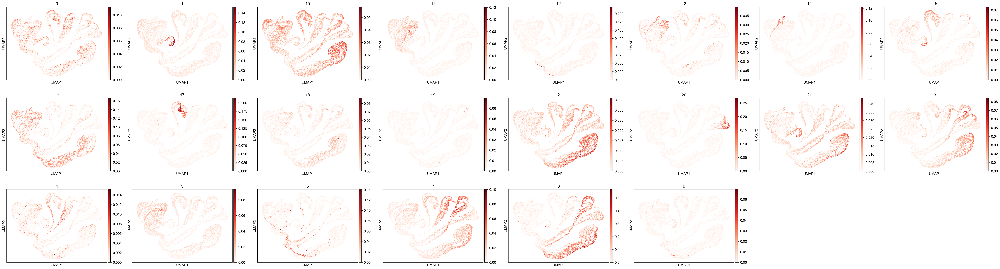

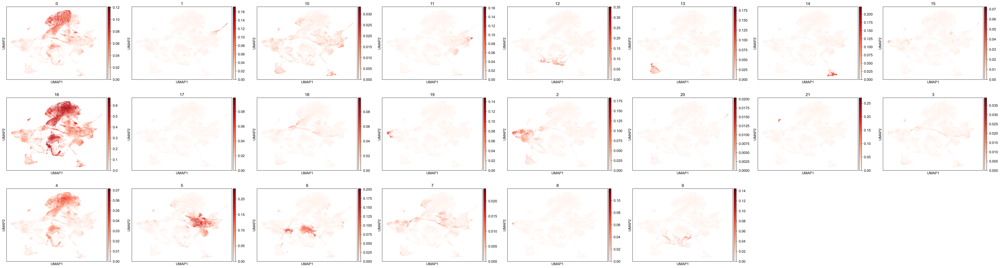

In [ ]:
_ad = singleCellTools.plotting.obsmToObs(ad_pub, "snCircadian_AUC")

sc.pl.umap(
    _ad[_ad.obs.eval("tissue == 'Root'")],
    color=_ad.uns["plot_obsm"],
    cmap="Reds",
    ncols=8,
)
sc.pl.umap(
    _ad[_ad.obs.eval("tissue == 'Shoot'")],
    color=_ad.uns["plot_obsm"],
    cmap="Reds",
    ncols=8,
)

In [ ]:
_df = ad_pub.obsm["snCircadian_AUC"].groupby(ad_pub.obs["celltype"]).agg("mean")

In [ ]:
import scipy

In [ ]:
_df = pd.DataFrame(_df >> F(scipy.stats.zscore), index=_df.index, columns=_df.columns)
ls_geneCat = np.where(_df.columns.str.contains(":"), "Shoot", "Root")

In [ ]:
ls_geneCat = np.where(_df.index.str.contains(":"), "Shoot", "Root")

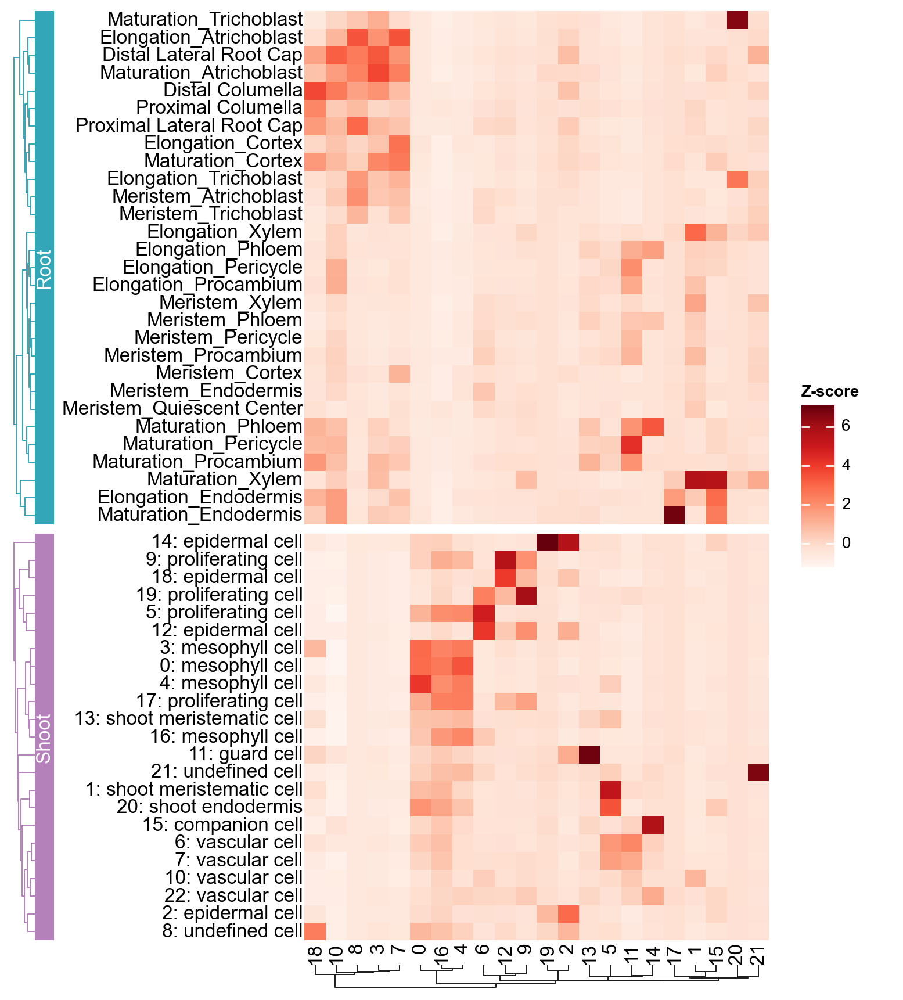

In [ ]:
h = ma.Heatmap(_df.values, cmap="Reds", width=4, height=8, label="Z-score")
h.hsplit(labels=ls_geneCat, order=["Root", "Shoot"])

h.add_left(ma.plotter.Labels(_df.index, align="right"))
h.add_bottom(ma.plotter.Labels(_df.columns, align="right"))

h.add_left(
    ma.plotter.Chunk(
        ["Root", "Shoot"],
        fill_colors=["#33A6B8", "#B481BB"],
        color="white",
        padding=1.2,
    ),
    pad=0.05,
)

h.add_dendrogram(
    "left", colors=["#33A6B8", "#B481BB"], method="ward", add_meta=False, size=0.2
)
h.add_dendrogram("bottom", method="ward", size=0.2)
h.add_legends(pad=-0.5)

h.render()

In [ ]:
dt_anno = {
    "0": "Mesophyll cell (Shoot)",
    "1": "Vascular cell (Unknown)",
    "2": "Epidermal cell (Shoot)",
    "3": "Atrichoblast (Root)",
    "4": "Proliferating cell & Mesophyll cell (Shoot)",
    "5": "Meristem & Endodermis (Shoot)",
    "6": "Proliferating cell & Mesophyll cell (Shoot)",
    "7": "Cortex (Root)",
    "8": "Unknown (Root)",
    "9": "Proliferating cell (Shoot)",
    "10": "Unknown (Root)",
    "11": "Vascular cell (Unknown)",
    "12": "Proliferating cell & Epidermal cell (Shoot)",
    "13": "Guard cell (Shoot)",
    "14": "Vascular cell (Unknown)",
    "15": "Unknown (Root)",
    "16": "Unknown (Shoot)",
    "17": "Endodermis (Root)",
    "18": "Unknown (Shoot)",
    "19": "Epidermal cell (Shoot)",
    "20": "Trichoblast (Root)",
    "21": "Unknown (Shoot)",
}
dt_anno = {i: f"{i}: {j}" for i, j in dt_anno.items()}
ad.obs["celltype"] = ad.obs["Cluster"].map(dt_anno)

In [ ]:
dt_annoForPlot = {}
for k, v in dt_anno.items():
    v = v.split(": ")[1]
    _ls = dt_annoForPlot.get(v, [])
    _ls.append(k)
    dt_annoForPlot[v] = _ls

In [ ]:
dt_annoForPlot

{'Mesophyll cell (Shoot)': ['0'],
 'Vascular cell (Unknown)': ['1', '11', '14'],
 'Epidermal cell (Shoot)': ['2', '19'],
 'Atrichoblast (Root)': ['3'],
 'Proliferating cell & Mesophyll cell (Shoot)': ['4', '6'],
 'Meristem & Endodermis (Shoot)': ['5'],
 'Cortex (Root)': ['7'],
 'Unknown (Root)': ['8', '10', '15'],
 'Proliferating cell (Shoot)': ['9'],
 'Proliferating cell & Epidermal cell (Shoot)': ['12'],
 'Guard cell (Shoot)': ['13'],
 'Unknown (Shoot)': ['16', '18', '21'],
 'Endodermis (Root)': ['17'],
 'Trichoblast (Root)': ['20']}

In [ ]:
dt_annoForPlot = {
    "Mesophyll cell (Shoot)": ["0"],
    "Guard cell (Shoot)": ["13"],
    "Proliferating cell & Mesophyll cell (Shoot)": ["4", "6"],
    'Proliferating cell & Epidermal cell (Shoot)': ['12'],
    "Proliferating cell (Shoot)": ["9"],
    "Epidermal cell (Shoot)": ["2", "19"],
    "Meristem & Endodermis (Shoot)": ["5"],
    "Unknown (Shoot)": ["16", "18", "21"],
    "Atrichoblast (Root)": ["3"],
    "Trichoblast (Root)": ["20"],
    "Cortex (Root)": ["7"],
    "Endodermis (Root)": ["17"],
    "Unknown (Root)": ["8", "10", "15"],
    "Vascular cell (Unknown)": ["1", "11", "14"],
}

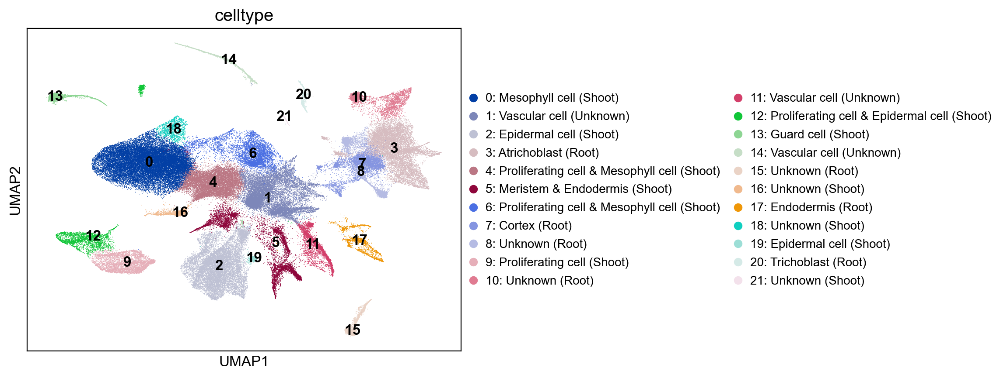

In [ ]:
ax = sc.pl.umap(ad, color="Cluster", legend_loc="on data", show=False)
sc.pl.umap(ad, color="celltype", ax=ax)

In [ ]:
dt_colors = singleCellTools.basic.getadataColor(ad, "Cluster")

In [ ]:
import adjustText

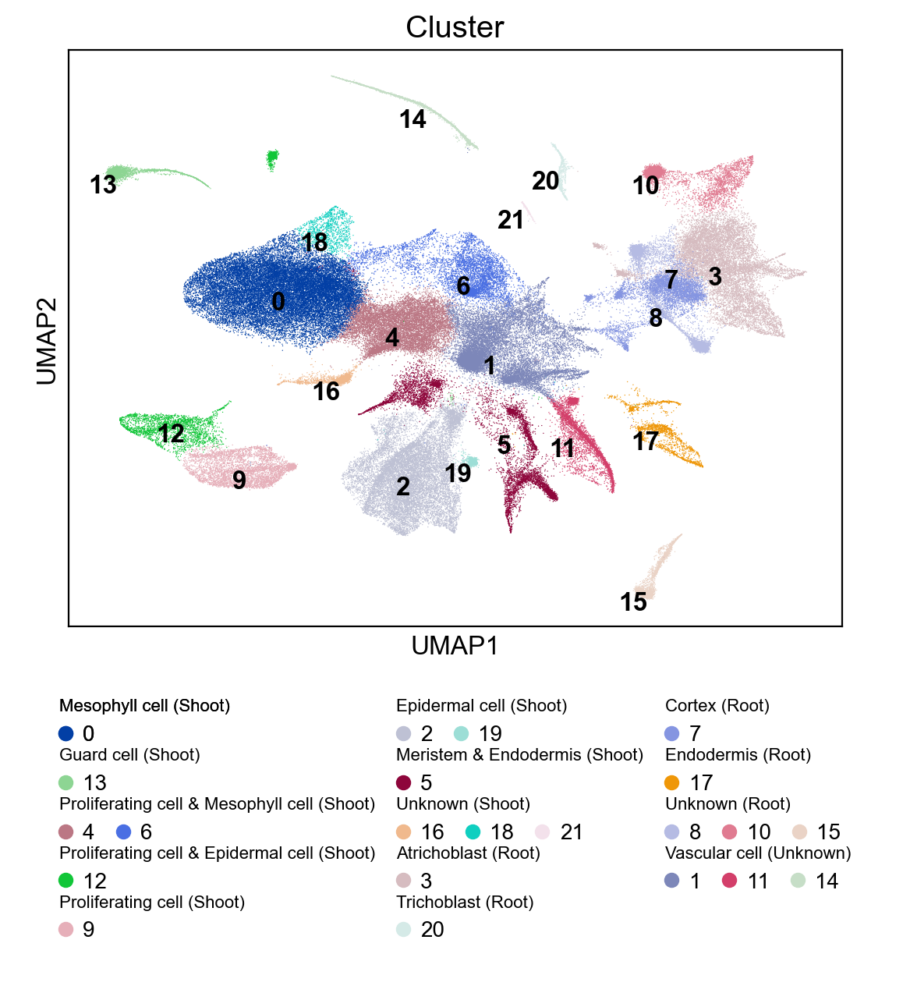

In [ ]:
ax = sc.pl.umap(ad, color="Cluster", title="Cluster", legend_loc="on data", show=False)
# sc.pl.umap(ad, color='celltype', title='Cluster', ax=ax, show=False)
# ax.get_legend().remove()

adjustText.adjust_text(ax.texts)
ls_legends = []
for celltype, ls_clusters in dt_annoForPlot.items():
    # ls_legendArgs = [('circle', x, dict(color=dt_colors[x])) for x in ls_clusters]
    # ls_legendArgs = [
    #     ('circle', x, dict(color=dt_colors[x])) for x in ls_clusters
    # ]
    ls_legends.append(
        legendkit.cat_legend(
            colors=[dt_colors[x] for x in ls_clusters],
            labels=ls_clusters,
            size=0.6,
            handle="circle",
            title=celltype,
            ncol=len(ls_clusters),
            title_fontproperties={"size": 8},
        )
    )

    # ls_legends.append(legendkit.cat_legend(legend_items=ls_legendArgs, title=celltype, ncol=len(ls_clusters)))
ls_meteLegends = []
j = 0
for i in [5, 5, 5]:
    ls_meteLegends.append(
        legendkit.vstack(ls_legends[j : i + j], spacing=1, padding=-1)
    )
    j += i

legendkit.hstack(
    ls_meteLegends, loc="out lower center", spacing=10, frameon=False, ax=ax
)

# GO

In [ ]:
from jpy_tools.otherTools import getGoDesc
import pandas as pd

In [ ]:
import jpy_tools.otherTools
import importlib

importlib.reload(jpy_tools.otherTools)

<module 'jpy_tools.otherTools' from '/public/home/liuzj/softwares/anaconda3/envs/circadian/lib/python3.8/site-packages/jpy_tools/otherTools.py'>

In [ ]:
df_araGo = pd.read_table("/data/Zhaijx/liuzj/data/Araport11/tair10/ath_go_parsed.txt")
df_goDesc = getGoDesc(df_araGo["goTerm"].unique().tolist(), retry=10, verbose=True)

100%|██████████| 7638/7638 [03:15<00:00, 39.07it/s] 
2023-09-05 20:27:16.799 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0016021, target : GO:0016020
2023-09-05 20:27:16.806 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0005887, target : GO:0005886
2023-09-05 20:27:16.916 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0052928, target : GO:0052927
2023-09-05 20:27:16.964 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0044106, target : GO:0009308
2023-09-05 20:27:16.996 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0004367, target : GO:0047952
2023-09-05 20:27:17.004 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0102092, target : GO:0033857
2023-09-05 20:27:17.009 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0004147, target : GO:0043754
2023-09-05 20:27:17.015 | WARNING  | jpy_tools.otherTools:getGoDesc:604 - query : GO:0102860, target : GO:0050184
2023-09-05 20:27:17.016 | WARNING  

In [ ]:
dt_goForGseapy = (
    df_araGo.merge(df_goDesc, left_on="goTerm", right_on="hitGO", how="left")
    .groupby(["hitName"])["gene"]
    .agg(list)
    .to_dict()
)

In [ ]:
import gseapy


def enrichrUsingGsea(ls_gene, dt_goSets, background=None, **kwargs):
    enr = gseapy.enrich(
        list(ls_gene), gene_sets=dt_goSets, background=background, **kwargs
    )
    enr.results = enr.results.assign(
        geneTotal=lambda x: x["Overlap"].str.split("/").str[1].astype(int),
        geneIn=lambda x: x["Overlap"].str.split("/").str[0].astype(int),
    )
    enr.results["-log10(p)"] = -np.log10(enr.results["Adjusted P-value"])
    return enr.results.copy().sort_values("Adjusted P-value").reset_index(drop=True)

In [ ]:
cpro = importr('clusterProfiler')
rBase = importr("base")
R = ro.r

In [ ]:
dt_goCategory =  df_goDesc['aspect'].to_dict()
df_araGo = df_araGo.assign(cate = lambda df:df['goTerm'].map(dt_goCategory))

df_termGene = df_araGo[["goTerm", "gene"]].rename(
    columns={"gene": "Gene stable ID", "goTerm": "GO term accession"}
)
df_termName = df_goDesc.reset_index()[["index", "hitName"]].rename(
    columns={"index": "GO term accession", "hitName": "GO term name"}
)
dt_goToCat = df_araGo.set_index("goTerm")["cate"].to_dict()



In [ ]:
# %store -r df_termGene df_termName

In [ ]:
dfR_termGene = py2r(df_termGene)
dfR_termName = py2r(df_termName)

In [ ]:
def enrichmentAnalysisGO(ls_gene, ls_background, qvalueCutoff=0.2, dt_goToCat=dt_goToCat):
    _go = cpro.enricher(
        R.c(*ls_gene),
        universe=R.c(*ls_background),
        TERM2GENE=dfR_termGene,
        TERM2NAME=dfR_termName,
        qvalueCutoff=qvalueCutoff,
    )
    df_go = r2py(rBase.as_data_frame(_go))
    df_go["-log10Pvalue"] = np.log10(df_go["pvalue"]) * -1
    if dt_goToCat:
        df_go["Category"] = df_go.index.map(dt_goToCat)
        df_go = df_go.sort_values(["Category", "pvalue"])
    else:
        df_go = df_go.sort_values(["pvalue"])
    return df_go